## OSM network_type = "cycle" - Untersuchen von "maxspeed"
------
Für unser Vorhersagemodell wollen wir die Höchstgeschwindigkeit (maxspeed) der Straßen mit einbeziehen.  

Dazu wollen wir folgendes untersuchen:
* Welche Arten von maxspeed existieren?
* Sind für alle Straßen Werte eingetragen, gibt es null-Werte?
* Welche maxspeed-Werte könnte man in Kategorien zusammenfassen?

Über Geofabrik wurden die OSM-Daten für die Stadt Berlin als pbf (Protocolbuffer Binary Format) heruntergeladen.  
Mittels pyrosm wird ein OSM-Objekt erstellt, um effizienter auf Daten zugreifen zu können.  

Da wir nur Straßen betrachten wollen, auf denen Fahrradfahren möglich ist, extrahieren mit get_network(network_type=cycle) genau diese Straßen und speichern sie in einem DataFrame (cycle_net_berlin)



In [41]:
# Daten wurden schon geladen und sind im Ordner data abgelegt
import os
import pyrosm
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module='pyrosm')

# Korrigierter Verzeichnis-Pfad
directory = "../../data"
file_path = os.path.join(directory, "berlin-latest.osm.pbf")

# OSM-Objekt erstellen
berlin_osm = pyrosm.OSM(file_path)

# Fahrradnetzwerk extrahieren
cycle_net_berlin = berlin_osm.get_network(network_type="cycling")




### Ausgabe der Werte von maxspeed  

* Es gibt sowohl numerische als nicht numerische Werte, die gesetzt worden sind.
* Wir müssen überlegen wie wir jetzt mit den Werten umgehen und wie unser Model später ungewöhnliche Werte interpretieren soll
* Es werden Straßen ausgegeben, die einen maxspeed von 100 und 120 haben und die nicht im cyclenet vorhanden sein dürften.   

In [42]:
maxspeed_values = cycle_net_berlin['maxspeed'].dropna().unique()
print("Alle Werte in der Spalte 'maxspeed':")
for value in maxspeed_values:
    print(value)

Alle Werte in der Spalte 'maxspeed':
50
30
60
10
20
40
5
70
15
walk
80
100
8
6
7
5 mph
120
17


### Strassen nach maxspeed und Häufigkeit geordnet 

* Für die Mehrzahl der Straßen (67%) liegt keine Information über maxspeed vor.

*  Wir wollen untersuchen:
     *  Straßen mit ungewöhnliche Werten (120 und 100 kmh)
     *  Straßen, die keinen maxspeed Wert haben


In [47]:
import pandas as pd

# Zähle die Vorkommen jedes Wertes in der Spalte 'maxspeed'
maxspeed_counts = cycle_net_berlin['maxspeed'].value_counts(dropna=False).reset_index()
maxspeed_counts.columns = ['Maxspeed', 'Anzahl Strassen']

# Ersetzen von NaN durch "No Data"
maxspeed_counts['Maxspeed'] = maxspeed_counts['Maxspeed'].fillna('No Data')


# Gesamtzahl der Straßen berechnen
gesamtzahl_strassen = maxspeed_counts['Anzahl Strassen'].sum()

# Anzahl der Straßen ohne maxspeede-Wert (NaN)
anzahl_no_data = maxspeed_counts[maxspeed_counts['Maxspeed'].isna()]['Anzahl Strassen'].sum()

# Falls wir 'No Data' als Text haben statt NaN
anzahl_no_data += maxspeed_counts[maxspeed_counts['Maxspeed'] == 'No Data']['Anzahl Strassen'].sum()

# Prozentsatz berechnen
prozent_no_data = (anzahl_no_data / gesamtzahl_strassen) * 100

print(f"Die Gesamtzahl der Straßen ist: {gesamtzahl_strassen}")
print(f"Die Anzahl der Straßen ohne 'maxspeed'-Wert ist: {anzahl_no_data}")
print(f"Prozentualer Anteil der Straßen ohne 'maxspeed'-Wert: {prozent_no_data:.2f}%")


print(maxspeed_counts)


Die Gesamtzahl der Straßen ist: 177849
Die Anzahl der Straßen ohne 'maxspeed'-Wert ist: 119212
Prozentualer Anteil der Straßen ohne 'maxspeed'-Wert: 67.03%
   Maxspeed  Anzahl Strassen
0   No Data           119212
1        30            34065
2        50            20375
3        10             2217
4        20             1024
5         5              437
6        60              310
7        70               60
8      walk               50
9        40               31
10       15               20
11        8               14
12      100                9
13        6                9
14        7                6
15    5 mph                4
16       80                2
17      120                2
18       17                2


### Wo liegen Straßen, die ungewöhnliche Werte haben

Wir wollen alle Straßen innerhalb Berlins betrachten, bei Ausgabe des network_type=cycle werden jedoch auch Straßen ausgegeben, die außerhalb der Berliner Grenzen, angrenzend zu Berlin vorhanden sind.  

Wir überprüfen zuerst, ob die Straßen wirklich innerhalb Berlins liegen:

* maxspeed 120 - die Strasse liegt nicht innerhalb Berlins
* maxspeed 100 - eine von 9 Strassen liegt innerhalb Berlins
    * die Ausgabe der Koordinaten dier betreffenden Strasse zeigt jedoch, dass es keine wirkliche Strasse ist, sondern nur ein kleiner Abschnitt von wenigen Metern vor einem Haus. Es handelt sich wahrscheinlich um eine fehlerhafte Eingabe. *(Die Koordinaten wurde bei https://www.openstreetmap.org/ eingeben und dort geprüft)* 

**--> Es gibt also keine Straße mit maxpseed 100 oder 120, die sich im "Cycle_Network" befindet**

Anzahl der Straßen mit maxspeed 120: 2
29125     MULTILINESTRING ((13.56369 52.38629, 13.56364 ...
129925    MULTILINESTRING ((13.56389 52.38726, 13.56383 ...
Name: geometry, dtype: geometry
Geometrien vor dem Clippen gültig: 29125     True
129925    True
dtype: bool


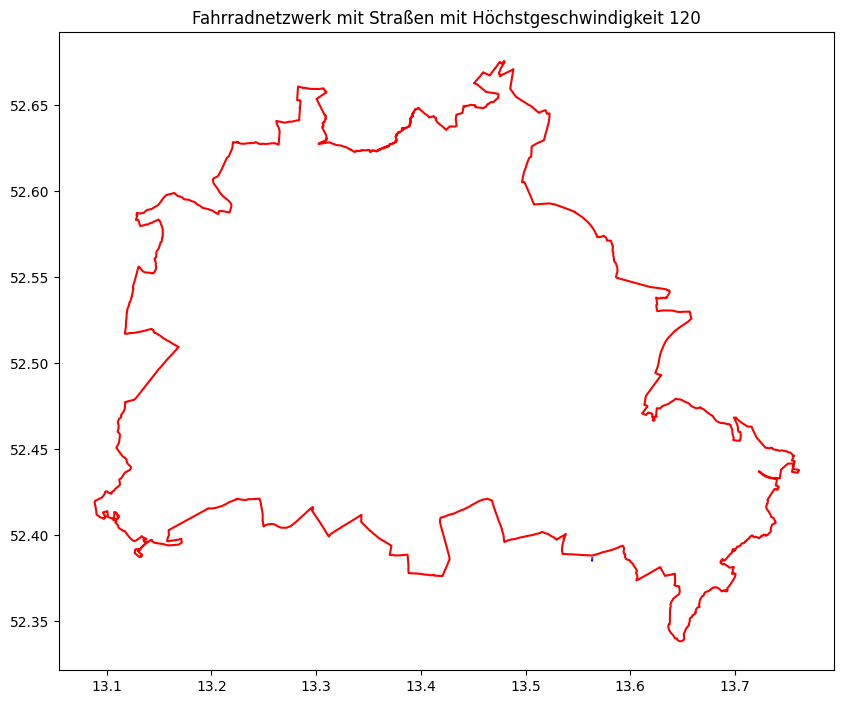

total_bounds vor dem Clippen: [13.56337261 52.38464355 13.56388664 52.38726044]
Geometrien innerhalb der Berliner Grenze: 29125     False
129925    False
dtype: bool
Geometrien nach dem Clippen gültig: Series([], dtype: bool)
total_bounds nach dem Clippen: [nan nan nan nan]


In [24]:
import pyrosm
import geopandas as gpd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module='pyrosm')



cycle_net_berlin = berlin_osm.get_network(network_type="cycling")

# Filter für Wege mit Höchstgeschwindigkeit 120
cycle_net_maxspeed_120 = cycle_net_berlin[cycle_net_berlin["maxspeed"] == "120"]

# Überprüfen der Anzahl der Straßen mit maxspeed 120
print("Anzahl der Straßen mit maxspeed 120:", len(cycle_net_maxspeed_120))
# Überprüfen der Koordinaten der Straßen
print(cycle_net_maxspeed_120.geometry)

if cycle_net_maxspeed_120.empty:
    print("Keine Straßen mit Höchstgeschwindigkeit 120 gefunden.")
else:
    # Sicherstellen, dass cycle_net_maxspeed_120 ein GeoDataFrame ist und das gleiche CRS verwendet
    cycle_net_maxspeed_120 = gpd.GeoDataFrame(cycle_net_maxspeed_120, geometry='geometry')
    cycle_net_maxspeed_120.set_crs(epsg=4326, inplace=True)  # EPSG:4326 ist das gebräuchliche CRS für Geodaten

    # Überprüfen der Geometrien vor dem Clippen
    print("Geometrien vor dem Clippen gültig:", cycle_net_maxspeed_120.geometry.is_valid)

    # Zuschnitt auf die Berliner Ausdehnung: Abrufen der administrativen Grenze
    boundaries = berlin_osm.get_boundaries(name="Berlin")
    berlin_boundary = boundaries[boundaries.name == "Berlin"].reset_index().geometry[0]
    berlin_boundary_gdf = gpd.GeoDataFrame(geometry=[berlin_boundary], crs=4326)

    # Visualisierung der Geometrien vor dem Clippen
    fig, ax = plt.subplots(figsize=(10, 10))
    cycle_net_maxspeed_120.plot(ax=ax, color='blue', markersize=5)
    berlin_boundary_gdf.boundary.plot(ax=ax, color='red')
    plt.title("Fahrradnetzwerk mit Straßen mit Höchstgeschwindigkeit 120")
    plt.show()

    # Überprüfen der total_bounds vor dem Clippen
    print("total_bounds vor dem Clippen:", cycle_net_maxspeed_120.total_bounds)

    # Überprüfen, ob die Geometrien innerhalb der Berliner Grenze liegen
    within_berlin = cycle_net_maxspeed_120.geometry.within(berlin_boundary)
    print("Geometrien innerhalb der Berliner Grenze:", within_berlin)

    # Zuschnitt des Fahrradnetzwerks auf die Berliner Grenzen
    cycle_net_maxspeed_120_clipped = gpd.clip(cycle_net_maxspeed_120, berlin_boundary_gdf)

    # Überprüfen der Geometrie nach dem Clippen
    print("Geometrien nach dem Clippen gültig:", cycle_net_maxspeed_120_clipped.geometry.is_valid)

    # Überprüfen der total_bounds nach dem Clippen
    print("total_bounds nach dem Clippen:", cycle_net_maxspeed_120_clipped.total_bounds)

    



Anzahl der Straßen mit maxspeed 100: 9
11584     MULTILINESTRING ((13.55656 52.38596, 13.55661 ...
22868     MULTILINESTRING ((13.55940 52.38791, 13.55944 ...
26984     MULTILINESTRING ((13.11070 52.53083, 13.11072 ...
32726     MULTILINESTRING ((13.56887 52.38574, 13.56911 ...
32735     MULTILINESTRING ((13.56911 52.38622, 13.56967 ...
42182     MULTILINESTRING ((13.55857 52.38628, 13.55860 ...
59188     MULTILINESTRING ((13.11480 52.51595, 13.11465 ...
128948    MULTILINESTRING ((13.57060 52.38918, 13.57066 ...
135856    MULTILINESTRING ((13.11801 52.51178, 13.11498 ...
Name: geometry, dtype: geometry
Geometrien vor dem Clippen gültig: 11584     True
22868     True
26984     True
32726     True
32735     True
42182     True
59188     True
128948    True
135856    True
dtype: bool


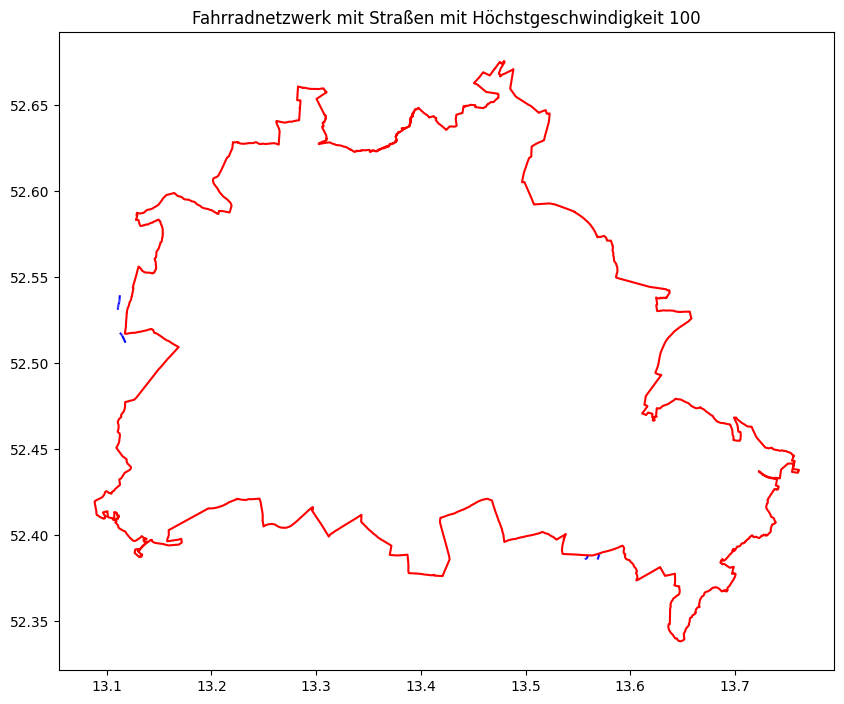

total_bounds vor dem Clippen: [13.11069679 52.38573837 13.57065678 52.53937149]
Geometrien innerhalb der Berliner Grenze: 11584     False
22868     False
26984     False
32726     False
32735     False
42182     False
59188     False
128948    False
135856    False
dtype: bool
Geometrien nach dem Clippen gültig: 22868    True
dtype: bool
total_bounds nach dem Clippen: [13.55887604 52.38823017 13.55889627 52.38826752]


In [38]:
import pyrosm
import geopandas as gpd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module='pyrosm')


# Filter für Wege mit Höchstgeschwindigkeit 120
cycle_net_maxspeed_100 = cycle_net_berlin[cycle_net_berlin["maxspeed"] == "100"]

# Überprüfen der Anzahl der Straßen mit maxspeed 120
print("Anzahl der Straßen mit maxspeed 100:", len(cycle_net_maxspeed_100))
# Überprüfen der Koordinaten der Straßen
print(cycle_net_maxspeed_100.geometry)

if cycle_net_maxspeed_120.empty:
    print("Keine Straßen mit Höchstgeschwindigkeit 100 gefunden.")
else:
    # Sicherstellen, dass cycle_net_maxspeed_120 ein GeoDataFrame ist und das gleiche CRS verwendet
    cycle_net_maxspeed_100 = gpd.GeoDataFrame(cycle_net_maxspeed_100, geometry='geometry')
    cycle_net_maxspeed_100.set_crs(epsg=4326, inplace=True)  # EPSG:4326 ist das gebräuchliche CRS für Geodaten

    # Überprüfen der Geometrien vor dem Clippen
    print("Geometrien vor dem Clippen gültig:", cycle_net_maxspeed_100.geometry.is_valid)

    # Zuschnitt auf die Berliner Ausdehnung: Abrufen der administrativen Grenze
    boundaries = berlin_osm.get_boundaries(name="Berlin")
    berlin_boundary = boundaries[boundaries.name == "Berlin"].reset_index().geometry[0]
    berlin_boundary_gdf = gpd.GeoDataFrame(geometry=[berlin_boundary], crs=4326)

    # Visualisierung der Geometrien vor dem Clippen
    fig, ax = plt.subplots(figsize=(10, 10))
    cycle_net_maxspeed_100.plot(ax=ax, color='blue', markersize=5)
    berlin_boundary_gdf.boundary.plot(ax=ax, color='red')
    plt.title("Fahrradnetzwerk mit Straßen mit Höchstgeschwindigkeit 100")
    plt.show()

    # Überprüfen der total_bounds vor dem Clippen
    print("total_bounds vor dem Clippen:", cycle_net_maxspeed_100.total_bounds)

    # Überprüfen, ob die Geometrien innerhalb der Berliner Grenze liegen
    within_berlin = cycle_net_maxspeed_100.geometry.within(berlin_boundary)
    print("Geometrien innerhalb der Berliner Grenze:", within_berlin)

    # Zuschnitt des Fahrradnetzwerks auf die Berliner Grenzen
    cycle_net_maxspeed_100_clipped = gpd.clip(cycle_net_maxspeed_100, berlin_boundary_gdf)

    # Überprüfen der Geometrie nach dem Clippen
    print("Geometrien nach dem Clippen gültig:", cycle_net_maxspeed_100_clipped.geometry.is_valid)

    # Überprüfen der total_bounds nach dem Clippen
    print("total_bounds nach dem Clippen:", cycle_net_maxspeed_100_clipped.total_bounds)


    


#### Ausgabe der Koordinaten der Straße mit maxspeed 100 innerhalb Berlins

In [37]:

if 22868 in cycle_net_maxspeed_100_clipped.index:
        geometry_22868 = cycle_net_maxspeed_100_clipped.loc[22868].geometry
        print("Geometrie des Eintrags mit Index 22868:", geometry_22868)
else:
    print("Eintrag mit Index 22868 nicht gefunden")
    

Geometrie des Eintrags mit Index 22868: LINESTRING (13.558896269164487 52.388230166504925, 13.558876037597656 52.388267517089844)


### Strassen mit definierter Höchstgeschwindigkeit

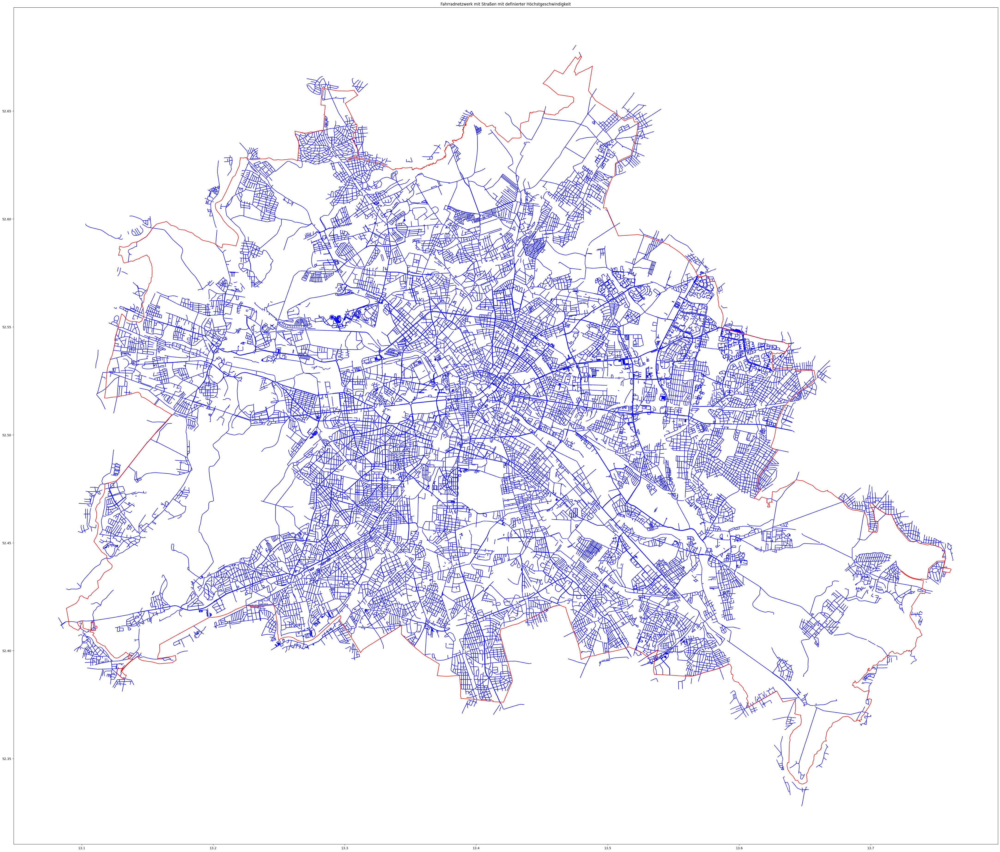

Geometrien nach dem Clippen gültig: 64064     True
7194      True
21919     True
24292     True
64065     True
          ... 
21673     True
54711     True
22956     True
132581    True
11358     True
Length: 56419, dtype: bool
total_bounds vor dem Clippen: [13.08233166 52.32797241 13.76267242 52.68038559]
total_bounds nach dem Clippen: [13.09020953 52.3404274  13.75694275 52.66043362]


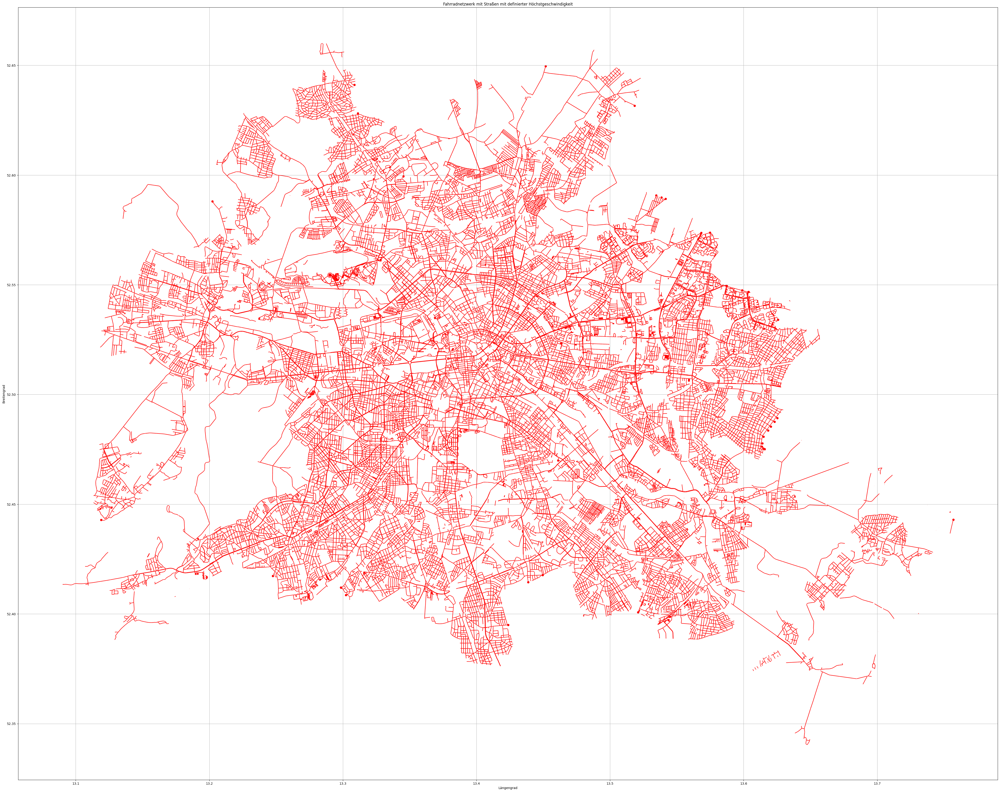

In [28]:
# Filter für Wege mit definierten Höchstgeschwindigkeiten (keine NaN-Werte)
cycle_net_defined_maxspeed = cycle_net_berlin[cycle_net_berlin["maxspeed"].notna()]

# Zuschnitt auf die Berliner Ausdehnung: Abrufen der administrativen Grenze
boundaries = berlin_osm.get_boundaries(name="Berlin")
berlin_boundary = boundaries[boundaries.name == "Berlin"].reset_index().geometry[0]

# Sicherstellen, dass cycle_net_defined_maxspeed ein GeoDataFrame ist und das gleiche CRS verwendet
cycle_net_defined_maxspeed = gpd.GeoDataFrame(cycle_net_defined_maxspeed, geometry='geometry')
cycle_net_defined_maxspeed.set_crs(epsg=4326, inplace=True)  # EPSG:4326 ist das gebräuchliche CRS für Geodaten

# Sicherstellen, dass die berlin_boundary das gleiche CRS verwendet
berlin_boundary_gdf = gpd.GeoDataFrame(geometry=[berlin_boundary], crs=4326)

# Ungültige Geometrien aussortieren
cycle_net_defined_maxspeed = cycle_net_defined_maxspeed[cycle_net_defined_maxspeed.geometry.is_valid]

# Überprüfen, ob es überhaupt noch gültige Geometrien gibt
if cycle_net_defined_maxspeed.empty:
    print("Keine gültigen Geometrien für Wege mit definierter Höchstgeschwindigkeit gefunden.")
else:
    # Visualisierung der Geometrien vor dem Clippen
    fig, ax = plt.subplots(figsize=(55, 55))
    cycle_net_defined_maxspeed.plot(ax=ax, color='blue', markersize=5)
    berlin_boundary_gdf.boundary.plot(ax=ax, color='red')
    plt.title("Fahrradnetzwerk mit Straßen mit definierter Höchstgeschwindigkeit")
    plt.show()

    # Zuschnitt des Fahrradnetzwerks auf die Berliner Grenzen
    cycle_net_defined_maxspeed_clipped = gpd.clip(cycle_net_defined_maxspeed, berlin_boundary_gdf)

    # Überprüfen der Geometrie nach dem Clippen
    print("Geometrien nach dem Clippen gültig:", cycle_net_defined_maxspeed_clipped.geometry.is_valid)

    # Überprüfen der total_bounds
    print("total_bounds vor dem Clippen:", cycle_net_defined_maxspeed.total_bounds)
    print("total_bounds nach dem Clippen:", cycle_net_defined_maxspeed_clipped.total_bounds)

    # Größe des Plots ändern
    fig, ax = plt.subplots(figsize=(55, 55))  # Größe des Plots in Zoll

    # Plotten des zugeschnittenen Fahrradnetzwerks mit definierter Höchstgeschwindigkeit
    cycle_net_defined_maxspeed_clipped.plot(ax=ax, color='red')

    # Zusätzliche Plot-Anpassungen
    plt.title("Fahrradnetzwerk mit Straßen mit definierter Höchstgeschwindigkeit")
    plt.xlabel("Längengrad")
    plt.ylabel("Breitengrad")
    plt.grid(True)

    # Aspekt manuell setzen, um den Fehler zu vermeiden
    # ax.set_aspect('1')

    # Plot anzeigen
    plt.show()

### Betrachtung der Strassen ohne definierte Höchstgeschwindigkeit (maxspeed)
- Was sind das für Straßen?
- was für Attribute sind noch hinterlegt für die Straßen? 

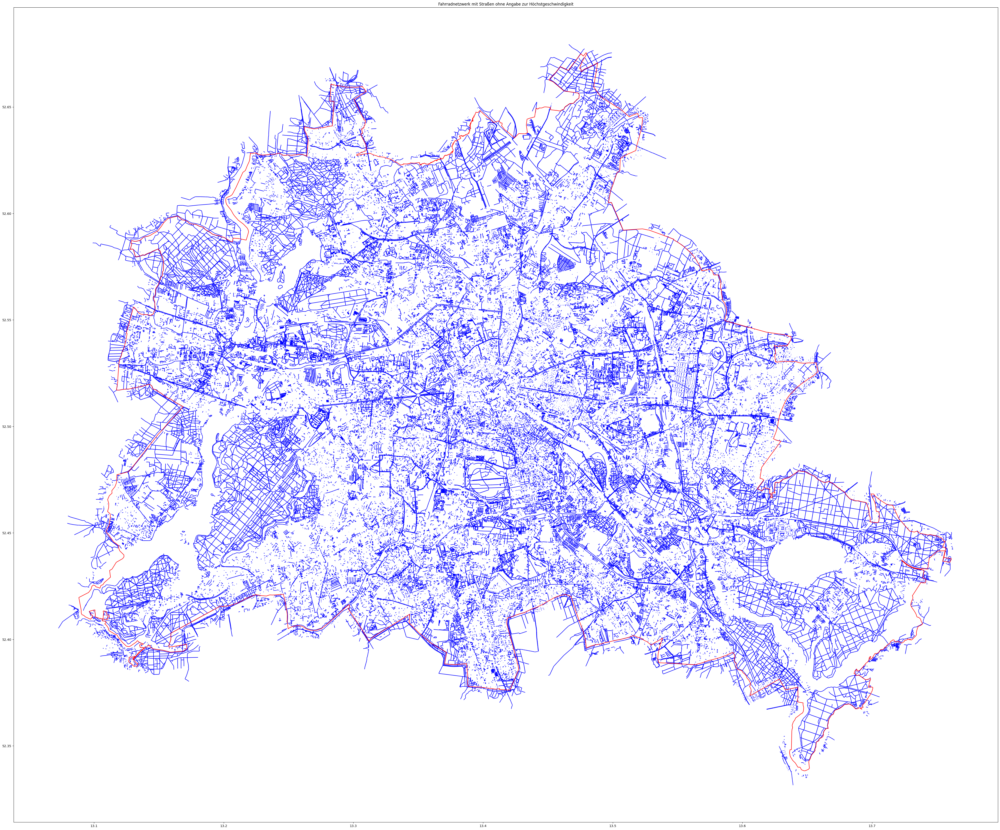

Geometrien nach dem Clippen gültig: 92941     True
119758    True
53106     True
84875     True
21920     True
          ... 
175301    True
136040    True
84899     True
119631    True
113160    True
Length: 111439, dtype: bool
total_bounds vor dem Clippen: [13.07260609 52.33149338 13.76249599 52.67938232]
total_bounds nach dem Clippen: [13.09187508 52.34122467 13.76100731 52.67311859]


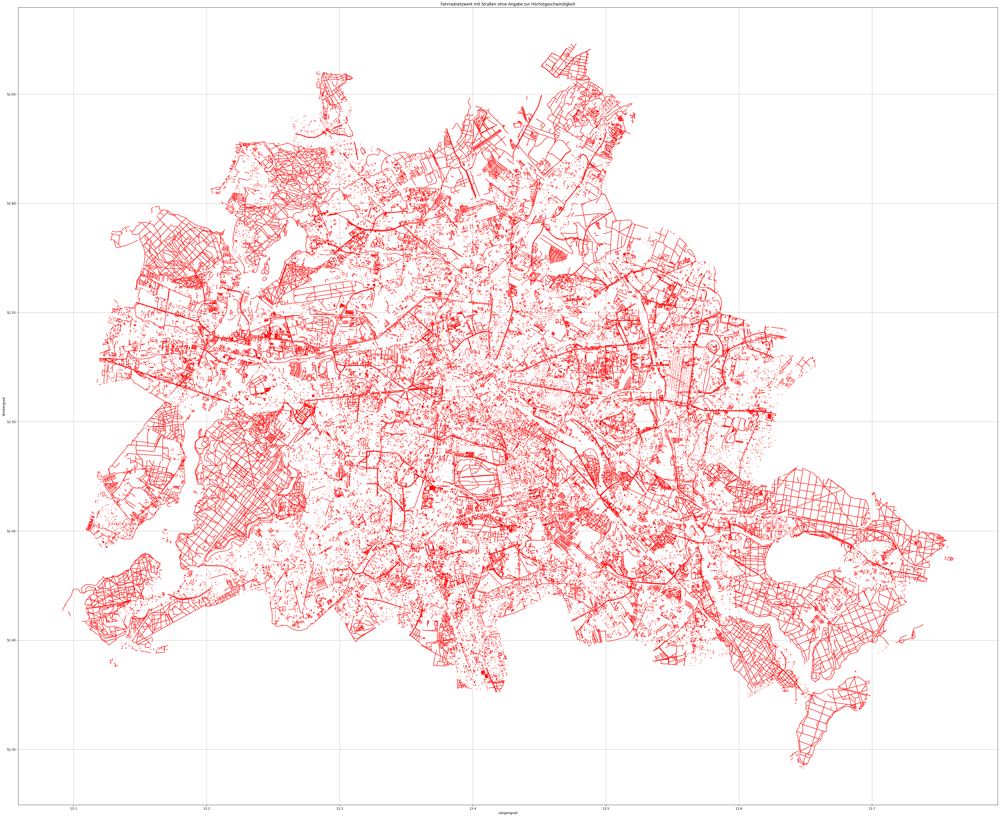

In [18]:
import pyrosm
import geopandas as gpd
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings("ignore", category=FutureWarning, module='pyrosm')



# Fahrradnetzwerk extrahieren
cycle_net_berlin = berlin_osm.get_network(network_type="cycling")

# Filter für Wege ohne Daten
cycle_net_maxspeed = cycle_net_berlin[cycle_net_berlin["maxspeed"].isna()]

# Zuschnitt auf die Berliner Ausdehnung: Abrufen der administrativen Grenze
boundaries = berlin_osm.get_boundaries(name="Berlin")
berlin_boundary = boundaries[boundaries.name == "Berlin"].reset_index().geometry[0]

# Sicherstellen, dass cycle_net_maxspeed ein GeoDataFrame ist und das gleiche CRS verwendet
cycle_net_maxspeed = gpd.GeoDataFrame(cycle_net_maxspeed, geometry='geometry')
cycle_net_maxspeed.set_crs(epsg=4326, inplace=True)  # EPSG:4326 ist das gebräuchliche CRS für Geodaten

# Sicherstellen, dass die berlin_boundary das gleiche CRS verwendet
berlin_boundary_gdf = gpd.GeoDataFrame(geometry=[berlin_boundary], crs=4326)

# Ungültige Geometrien aussortieren
cycle_net_maxspeed = cycle_net_maxspeed[cycle_net_maxspeed.geometry.is_valid]

# Überprüfen, ob es überhaupt noch gültige Geometrien gibt
if cycle_net_maxspeed.empty:
    print("Keine gültigen Geometrien für Wege ohne Höchstgeschwindigkeit gefunden.")
else:
    # Visualisierung der Geometrien vor dem Clippen
    fig, ax = plt.subplots(figsize=(55, 55))
    cycle_net_maxspeed.plot(ax=ax, color='blue', markersize=5)
    berlin_boundary_gdf.boundary.plot(ax=ax, color='red')
    plt.title("Fahrradnetzwerk mit Straßen ohne Angabe zur Höchstgeschwindigkeit")
    plt.show()

    # Zuschnitt des Fahrradnetzwerks auf die Berliner Grenzen
    cycle_net_maxspeed_clipped = gpd.clip(cycle_net_maxspeed, berlin_boundary_gdf)

    # Überprüfen der Geometrie nach dem Clippen
    print("Geometrien nach dem Clippen gültig:", cycle_net_maxspeed_clipped.geometry.is_valid)

    # Überprüfen der total_bounds
    print("total_bounds vor dem Clippen:", cycle_net_maxspeed.total_bounds)
    print("total_bounds nach dem Clippen:", cycle_net_maxspeed_clipped.total_bounds)

    # Größe des Plots ändern
    fig, ax = plt.subplots(figsize=(55, 55))  # Größe des Plots in Zoll

    # Plotten des zugeschnittenen Fahrradnetzwerks mit Höchstgeschwindigkeit None
    cycle_net_maxspeed_clipped.plot(ax=ax, color='red')

    # Zusätzliche Plot-Anpassungen
    plt.title("Fahrradnetzwerk mit Straßen ohne Angabe zur Höchstgeschwindigkeit")
    plt.xlabel("Längengrad")
    plt.ylabel("Breitengrad")
    plt.grid(True)

    # Aspekt manuell setzen, um den Fehler zu vermeiden
    # ax.set_aspect('1')

    # Plot anzeigen
    plt.show()






### Art der Strassen mit nicht definierter Geschwindigkeit
- **service** -> Erschließungsstrassen, Zugang zu Park oder Sportplätzen auch BSR...

- **path** -> allg . Weg ohne besondere Nutzungsbedeutung, zu schmal für KFZ u.ä.
  
- **cycleway** -> Fahradweg
  
- **footway** -> Fußgängerweg
 
- **track** -> Land- und Forstwirtschaftsweg
  
- **living street** -> Verkehrsberuhigter Bereich, Spielstraße (SchritTgeschwindigkeit)
  
- **residential** -> Eine schmalere Straße, die überwiegend von Anliegern benutzt wird. Kaum Durchgangsverkehr
  
- **pedestrian** -> Fußgängerzone
  
- **tertiary** -> Kreisstraße, Verbindungsstraßen zw. Dörfern u. Gemeinden
  
- **bridleway** -> Reitwege, auf denen auch Fahrräder u. KFZ fahren darf
  
- **secondary** -> Landstraße, überregionale Verbindungsstraße zwischen größeren Orten unterhalb der Klasse Bundesstraße erfasst
  
- **unclassified** -> bezeichnet eine öffentliche Nebenstraße, die Siedlungsziele erschließt und neben landwirtschaftlichem Verkehr einen überwiegenden Anteil von Siedlungsverkehr führt
  
- **steps** -> Treppe
  
- **secondary_link** -> Verbindungswege von Landes- und Staatsstraßen. Da Landesstraßen oft nicht kreuzungsfrei ausgebaut werden, handelt es sich in der Regel um Rechtsabbiegerspuren oder Verbindungswege zum Wenden.
  
- **construction** -> Straße, die sich aktuell im Bau befindet oder deren Bau in Kürze beginn
  
 

### Verteilung der Straßentypen ohne maxspeed

* die meisten Straßen (72%) ohne maxspeed Wert sind vom Typ "service". Das sind kurze Zufahrtswege zu Häusern, Parkplätzen etc. Eine 
* Alle anderen Straßentypen ohne maxspeed Wert, die mehr als 1% der Gesamtzahl ausmachen, sind Straßen, bei denen ebenfalls nicht unbedingt ein maxspeed definiert werden muss, weil sie Fußwege sind, Pfade, Fahrradwege...

-> Wir möchten das Feature maxspeed für unser Model nutzen und werden im weiteren Verlauf Werte für die Straßentypen ohne maxspeed Wert definieren.


highway
service           71.971781
path               8.625809
cycleway           5.882797
footway            5.532161
track              4.288159
living_street      1.915915
residential        0.675268
pedestrian         0.353991
tertiary           0.154347
bridleway          0.127504
secondary          0.126665
unclassified       0.116599
steps              0.088917
secondary_link     0.041942
construction       0.030198
tertiary_link      0.013421
primary_link       0.012583
busway             0.012583
primary            0.011744
elevator           0.009227
street_lamp        0.003355
road               0.001678
proposed           0.000839
services           0.000839
rest_area          0.000839
bus_stop           0.000839
Name: proportion, dtype: float64


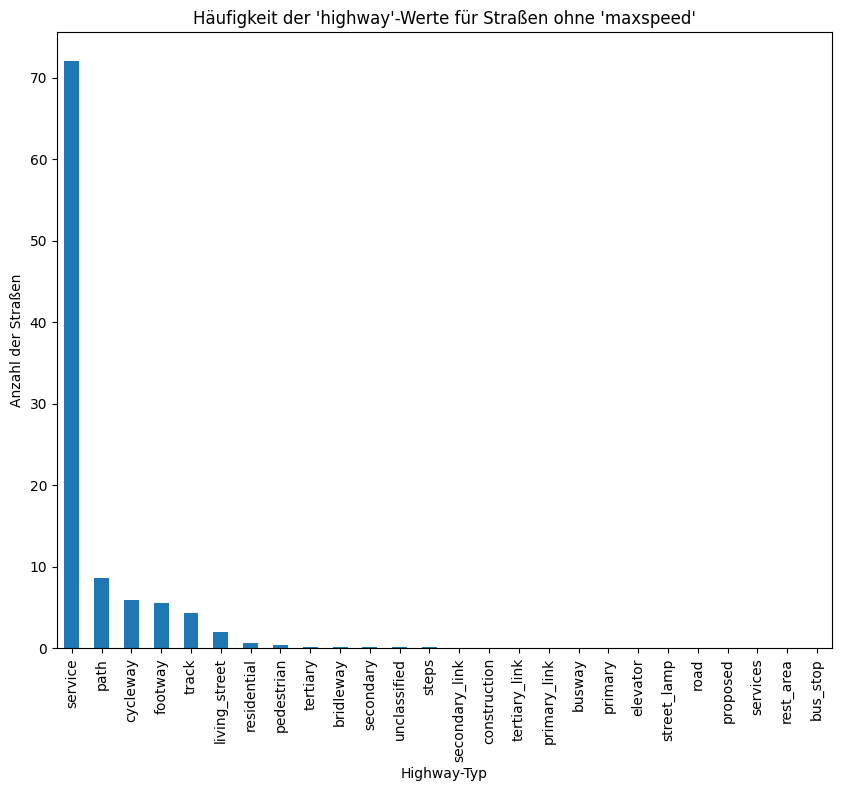

In [48]:
# Filter für Wege ohne Daten in der Spalte "maxspeed"
cycle_net_no_maxspeed = cycle_net_berlin[cycle_net_berlin["maxspeed"].isna()]

# Häufigkeitstabelle für die Werte in der Spalte "highway"
highway_counts = cycle_net_no_maxspeed["highway"].value_counts(normalize=True)*100

# Ausgabe der Häufigkeitstabelle
print(highway_counts)

# Visualisierung der Häufigkeitstabelle als Balkendiagramm
plt.figure(figsize=(10, 8))
highway_counts.plot(kind='bar')
plt.title("Häufigkeit der 'highway'-Werte für Straßen ohne 'maxspeed'")
plt.xlabel("Highway-Typ")
plt.ylabel("Anzahl der Straßen")
plt.show()

### Ausgabe der Straßen mit maxspeed "x"

Geometrien vor dem Clippen gültig: 0         True
4         True
8         True
9         True
11        True
          ... 
177704    True
177712    True
177713    True
177714    True
177716    True
Length: 20375, dtype: bool
total_bounds nach dem Filtern: [13.08912563 52.34423065 13.75766373 52.66016006]
Geometrien nach dem Clippen gültig: 31438     True
31440     True
120966    True
35989     True
175495    True
          ... 
23409     True
145214    True
11153     True
867       True
66740     True
Length: 19883, dtype: bool
total_bounds nach dem Clippen: [13.09020953 52.34423065 13.75694275 52.6599518 ]


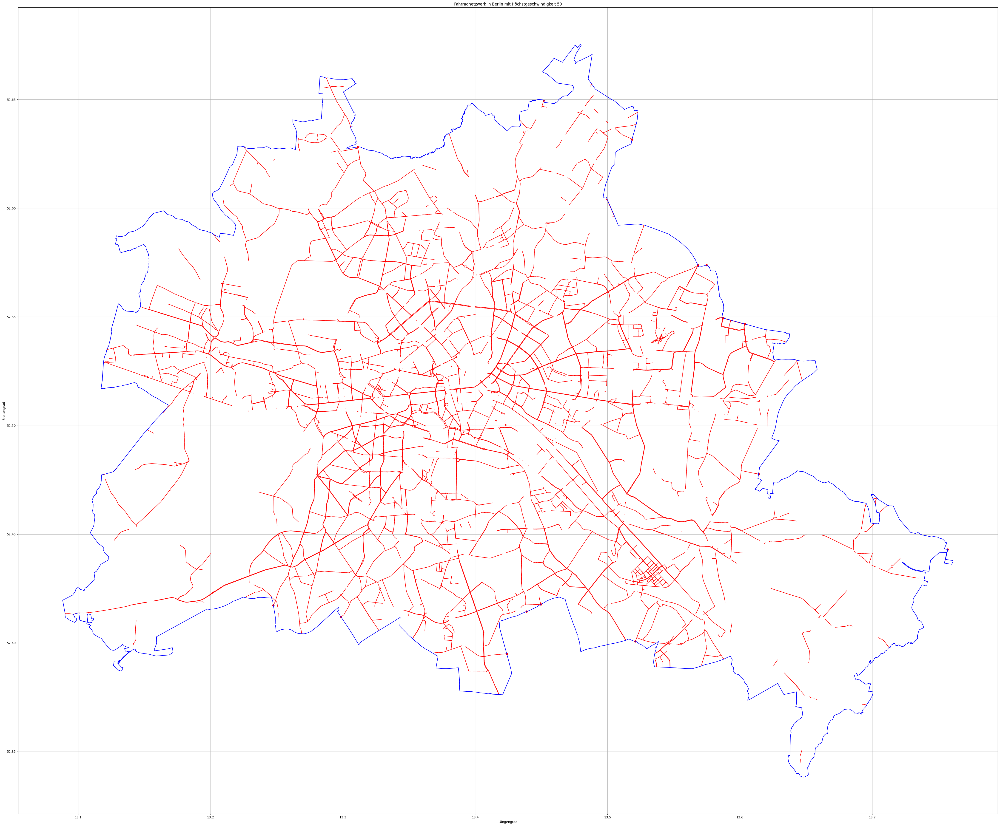

In [61]:
import os
import pyrosm
import geopandas as gpd
import matplotlib.pyplot as plt


# Filter für Wege mit Höchstgeschwindigkeit 50
cycle_net_maxspeed = cycle_net_berlin[cycle_net_berlin["maxspeed"] == "50"]

# Zuschnitt auf die Berliner Ausdehnung: Abrufen der administrativen Grenze
boundaries = berlin_osm.get_boundaries(name="Berlin")
berlin_boundary = boundaries[boundaries.name == "Berlin"].reset_index().geometry[0]

# Sicherstellen, dass cycle_net_maxspeed ein GeoDataFrame ist und das gleiche CRS verwendet
cycle_net_maxspeed = gpd.GeoDataFrame(cycle_net_maxspeed, geometry='geometry')
cycle_net_maxspeed.set_crs(epsg=4326, inplace=True)  # EPSG:4326 ist das gebräuchliche CRS für Geodaten

# Sicherstellen, dass die berlin_boundary das gleiche CRS verwendet
berlin_boundary_gdf = gpd.GeoDataFrame(geometry=[berlin_boundary], crs=4326)

# Überprüfen der Geometrie
print("Geometrien vor dem Clippen gültig:", cycle_net_maxspeed.geometry.is_valid)

# Filtern der Geometrien, die innerhalb der Berliner Grenzen liegen
cycle_net_maxspeed = cycle_net_maxspeed[cycle_net_maxspeed.intersects(berlin_boundary)]

# Überprüfen der total_bounds nach dem Filtern
print("total_bounds nach dem Filtern:", cycle_net_maxspeed.total_bounds)

# Zuschnitt des Fahrradnetzwerks auf die Berliner Grenzen
cycle_net_maxspeed_clipped = gpd.clip(cycle_net_maxspeed, berlin_boundary_gdf)

# Überprüfen der Geometrie nach dem Clippen
print("Geometrien nach dem Clippen gültig:", cycle_net_maxspeed_clipped.geometry.is_valid)

# Überprüfen der total_bounds
print("total_bounds nach dem Clippen:", cycle_net_maxspeed_clipped.total_bounds)

# Größe des Plots ändern
fig, ax = plt.subplots(figsize=(55, 55))  # Größe des Plots in Zoll

# Plotten des zugeschnittenen Fahrradnetzwerks mit Höchstgeschwindigkeit 120
if not cycle_net_maxspeed_clipped.empty:
    cycle_net_maxspeed_clipped.plot(ax=ax, color='red')

# Plotten der Berliner Grenze
berlin_boundary_gdf.boundary.plot(ax=ax, color='blue')

# Zusätzliche Plot-Anpassungen
plt.title("Fahrradnetzwerk in Berlin mit Höchstgeschwindigkeit 50")
plt.xlabel("Längengrad")
plt.ylabel("Breitengrad")
plt.grid(True)

# Aspekt manuell setzen, um den Fehler zu vermeiden
#ax.set_aspect('equal')

# Plot anzeigen
plt.show()


## Bereinigung der Daten
----------
Zum Trainieren unseres Modell benötigen alle Straßen maxspeed Werte.   
Um bessere Trainingseffekte erzielen zu können, wollen wir Werte in Kategorien zusammenfassen. (Momentan gibt es 18 verschiedene Wertekategorien) 

Wir machen folgendes:

**1. Setzen fehlender maxspeed Werte je nach Straßentyp**  
**2. Werte in Kategorien zusammenfassen**

--> um nur mit Daten(Geometrien) die innerhalb Berlins zu arbeiten. 
Laden wir den bereinigten Datensatz des cyclenets (cycle_net_berlin_cleaned.geojsn) und arbeiten mit diesem weiter.


In [1]:
import geopandas as gpd

# Pfad zur GeoJSON-Datei
file_path = "../../data/cycle_net_berlin_cleaned.geojson"

# Laden der GeoJSON-Datei
berlin_cyclenet = gpd.read_file(file_path)

**kurze Überprüfung des geojsn**  

die Angaben stimmen überein.
bzw. fällt der Wert 120 weg, weil ja wie vorher betrachtet, nicht innerhalb der Grenzen Berlins liegt.  
Der Wert 100 ist weiterhin vorhanden, was ebenfalls korrekt ist.  

--> wir können diesen bereinigten Datensatz benutzen


In [4]:
maxspeed_values = berlin_cyclenet['maxspeed'].dropna().unique()
print("Alle Werte in der Spalte 'maxspeed':")
for value in maxspeed_values:
    print(value)

Alle Werte in der Spalte 'maxspeed':
30
50
60
10
20
40
5
70
15
walk
80
8
6
7
100
5 mph
17


### 1. fehlende Werte bei maxspeed setzen

1. Entscheiden welche Werte für jeweiligen Straßentyp gesetzt werden soll
2. Werte setzen

#### 1.1. Straßentypen einen maxspeed-Wert zuordnen

Wir analysieren, die einzelnen Straßentypen mit ihren genrellen maxspeed-Werten und finden so heraus, welche Werte für diese Straßentypen grundsätzlich gesetzt werden können. 

Wir definieren folgende Werte (in km/h), aufgrund der Straßenverkehrsordnung,logischen Überlegungen oder Analyse des Datensatzes und schon gesetzter Werte pro Straßentyp:

* service: 20 (bei Einfahrten, Zugangsstraßen etc. wird grundsätzlich etwas langsamer gefahren
* path: 20
* cycleway: 20
* footway: 5 (walk)
* track: 20
* living_street: 10
* primary: 50
* secondary: 50
* tertiary: 50
* residential: 30
* alle anderen Straßen ohne Wert soll 5 zugeordnet werden

  -> grundsätzlich haben wir den grob überschlagenen Mittelwert der gesetzten Werte für maxspeed pro Straßentyp als Wert für fehlenden maxspeed ausgewählt.
  Wir haben auch bei Straßentypen bei den prozentual gesehen nur wenige Straßen existieren, für die maxspeed Werte gesetzt sind, die gesetzten Werte als Grundlage für unsere Entscheidung genommen.  
  z.B.: Straßentyp "service" - nur knapp 8% dieser Straßen haben eine gesetzten maxspeed Wert. Die beiden am häufigsten gesetzen maxspeed Werte sind 30 und 10 - wir entscheiden für den Mittelwert 20.
  

**Analyse Straßentypen ohne maxspeed**

Es werden nur die Straßen betrachtet die >1% vertreten sind, zudem noch primary, secondary und tertiary, weil das Straßen mit höherer Geschwindigkeit sind.  
Die Anzahl der anderen Straßentypen ist so gering, dass sie uns nicht relevant erscheint und wir pauschal Werte setzen werden.  
Wir gehen davon aus, dass das den Datensatz nicht relevant verzerren wird.   
  
Zudem ist bei Analyse der Straßentypen (siehe notebook [osm_highway](osm_highway.ipynb) ) aufgefallen, dass bestimmte Typen von Straßen nur sehr selten vorhanden sind und wir diese ohnehin in die Kategorie "rare" einsortiert haben. 



In [8]:
import pandas as pd

def analyze_street_type(berlin_cyclenet, street_type):
    # Gesamtzahl der Straßen des Typs 'street_type' berechnen
    total_streets = berlin_cyclenet[berlin_cyclenet["highway"] == street_type].shape[0]

    # Anzahl der Straßen des Typs 'street_type' ohne 'maxspeed'-Wert berechnen
    streets_no_maxspeed = berlin_cyclenet[(berlin_cyclenet["highway"] == street_type) & (berlin_cyclenet["maxspeed"].isna())]
    total_streets_no_maxspeed = streets_no_maxspeed.shape[0]

    # Prozentsatz der Straßen des Typs 'street_type' ohne 'maxspeed'-Wert berechnen
    percentage_no_maxspeed = (total_streets_no_maxspeed / total_streets) * 100

    # Prozentuale Verteilung der 'maxspeed'-Werte für Straßen des Typs 'street_type' mit 'maxspeed'-Wert berechnen
    streets_with_maxspeed = berlin_cyclenet[(berlin_cyclenet["highway"] == street_type) & (berlin_cyclenet["maxspeed"].notna())]
    maxspeed_counts = streets_with_maxspeed["maxspeed"].value_counts(normalize=True) * 100

    # Ausgabe der Ergebnisse
    print(f"Gesamtzahl der '{street_type}'-Straßen: {total_streets}")
    print(f"Anzahl der '{street_type}'-Straßen ohne 'maxspeed'-Wert: {total_streets_no_maxspeed} ({percentage_no_maxspeed:.2f}%)")
    print(f"\nProzentuale Verteilung der 'maxspeed'-Werte bei '{street_type}'-Straßen mit 'maxspeed'-Wert:")
    print(maxspeed_counts)
    print("\n")

# Liste der Straßentypen, die analysiert werden sollen
street_types = ["service", "path",  "cycleway", "footway", "track", "living_street", "residential", "primary", "secondary", "tertiary"]

# Anwendung der Funktion auf alle Straßentypen in der Liste
for street_type in street_types:
    analyze_street_type(berlin_cyclenet, street_type)


Gesamtzahl der 'service'-Straßen: 87405
Anzahl der 'service'-Straßen ohne 'maxspeed'-Wert: 80623 (92.24%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'service'-Straßen mit 'maxspeed'-Wert:
maxspeed
30       51.091124
10       26.585078
20        9.761132
5         5.912710
50        5.131230
walk      0.501327
40        0.368623
8         0.176939
15        0.162194
6         0.132704
60        0.058980
5 mph     0.058980
17        0.029490
7         0.029490
Name: proportion, dtype: float64


Gesamtzahl der 'path'-Straßen: 8977
Anzahl der 'path'-Straßen ohne 'maxspeed'-Wert: 8967 (99.89%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'path'-Straßen mit 'maxspeed'-Wert:
maxspeed
30    70.0
40    10.0
10    10.0
7     10.0
Name: proportion, dtype: float64


Gesamtzahl der 'cycleway'-Straßen: 7001
Anzahl der 'cycleway'-Straßen ohne 'maxspeed'-Wert: 6984 (99.76%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'cycleway'-Straßen mit 'maxspeed'-Wert:
maxspeed
30    70.588235
10   

#### 1.2. Straßentypen einen maxspeed-Wert zuordnen

In [9]:


# Definiere die Standardwerte für 'maxspeed' basierend auf dem 'highway'-Typ
default_speeds = {
    "service": 20,
    "path": 20,
    "cycleway": 20,
    "footway": 5,
    "track": 20,
    "living_street": 10,
    "primary": 50,
    "secondary": 50,
    "tertiary": 50,
    "residential": 30
}

# Funktion zum Zuweisen von 'maxspeed'-Werten basierend auf dem 'highway'-Typ
def assign_maxspeed(row):
    if pd.isna(row['maxspeed']):
        return default_speeds.get(row['highway'], 5)
    return row['maxspeed']

# Wende die Funktion auf die GeoDataFrame an
berlin_cyclenet['maxspeed'] = berlin_cyclenet.apply(assign_maxspeed, axis=1)

# Ausgabe der ersten fünf Zeilen des aktualisierten DataFrames
berlin_cyclenet.head()



,access,area,bicycle,bicycle_road,bridge,busway,cycleway,est_width,foot,footway,...,tunnel,turn,width,id,timestamp,version,tags,osm_type,length,geometry
0,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4045194,1698917575,23,"{ ""visible"": false, ""cycleway:both"": ""no"", ""de...",way,144.0,"MULTILINESTRING ((13.53136 52.49263, 13.53136 ..."
1,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4045220,1686491460,51,"{ ""visible"": false, ""cycleway:both"": ""no"", ""la...",way,93.0,"MULTILINESTRING ((13.52694 52.48969, 13.52639 ..."
2,None,None,None,None,None,None,None,None,None,None,...,None,None,5,4045223,1669445555,27,"{ ""visible"": false, ""cycleway:both"": ""no"", ""na...",way,136.0,"MULTILINESTRING ((13.52477 52.48558, 13.52484 ..."
3,None,None,optional_sidepath,None,None,None,None,None,use_sidepath,None,...,None,None,None,4045243,1702120697,50,"{ ""visible"": false, ""cycleway:left"": ""no"", ""cy...",way,91.0,"MULTILINESTRING ((13.45420 52.51571, 13.45431 ..."
4,None,None,None,None,None,None,None,None,None,None,...,None,None,None,4045655,1604058534,10,"{ ""visible"": false, ""maxspeed:type"": ""DE:zone3...",way,197.0,"MULTILINESTRING ((13.37261 52.59296, 13.37347 ..."


**Überprüfen ob es null noch Werte bei maxspeed gibt**

Es gibt keine Straßen mehr für die kein Wert für maxspeed gesetzt ist

In [10]:
# Zähle die Vorkommen jedes Wertes in der Spalte 'maxspeed'
maxspeed_counts = berlin_cyclenet['maxspeed'].value_counts(dropna=False).reset_index()
maxspeed_counts.columns = ['Maxspeed', 'Anzahl Strassen']

# Ersetzen von NaN durch "No Data"
maxspeed_counts['Maxspeed'] = maxspeed_counts['Maxspeed'].fillna('No Data')


# Gesamtzahl der Straßen berechnen
gesamtzahl_strassen = maxspeed_counts['Anzahl Strassen'].sum()

# Anzahl der Straßen ohne maxspeede-Wert (NaN)
anzahl_no_data = maxspeed_counts[maxspeed_counts['Maxspeed'].isna()]['Anzahl Strassen'].sum()

# Falls wir 'No Data' als Text haben statt NaN
anzahl_no_data += maxspeed_counts[maxspeed_counts['Maxspeed'] == 'No Data']['Anzahl Strassen'].sum()

# Prozentsatz berechnen
prozent_no_data = (anzahl_no_data / gesamtzahl_strassen) * 100

print(f"Die Gesamtzahl der Straßen ist: {gesamtzahl_strassen}")
print(f"Die Anzahl der Straßen ohne 'maxspeed'-Wert ist: {anzahl_no_data}")
print(f"Prozentualer Anteil der Straßen ohne 'maxspeed'-Wert: {prozent_no_data:.2f}%")


print(maxspeed_counts)

Die Gesamtzahl der Straßen ist: 167881
Die Anzahl der Straßen ohne 'maxspeed'-Wert ist: 0
Prozentualer Anteil der Straßen ohne 'maxspeed'-Wert: 0.00%
   Maxspeed  Anzahl Strassen
0        20           101120
1        30            32612
2        50            19883
3         5             7223
4        10             2119
5        10             2084
6        20              940
7        30              656
8         5              434
9        50              332
10       60              303
11     walk               50
12       70               39
13       40               31
14       15               19
15        8               14
16        6                9
17        7                4
18    5 mph                4
19       80                2
20       17                2
21      100                1


In [12]:
def analyze_street_type(cberlin_cyclenet, street_type):
    # Gesamtzahl der Straßen des Typs 'street_type' berechnen
    total_streets = berlin_cyclenet[berlin_cyclenet["highway"] == street_type].shape[0]

    # Anzahl der Straßen des Typs 'street_type' ohne 'maxspeed'-Wert berechnen
    streets_no_maxspeed = berlin_cyclenet[(berlin_cyclenet["highway"] == street_type) & (berlin_cyclenet["maxspeed"].isna())]
    total_streets_no_maxspeed = streets_no_maxspeed.shape[0]

    # Prozentsatz der Straßen des Typs 'street_type' ohne 'maxspeed'-Wert berechnen
    percentage_no_maxspeed = (total_streets_no_maxspeed / total_streets) * 100

    # Prozentuale Verteilung der 'maxspeed'-Werte für Straßen des Typs 'street_type' mit 'maxspeed'-Wert berechnen
    streets_with_maxspeed = berlin_cyclenet[(berlin_cyclenet["highway"] == street_type) & (berlin_cyclenet["maxspeed"].notna())]
    maxspeed_counts = streets_with_maxspeed["maxspeed"].value_counts(normalize=True) * 100

    # Ausgabe der Ergebnisse
    print(f"Gesamtzahl der '{street_type}'-Straßen: {total_streets}")
    print(f"Anzahl der '{street_type}'-Straßen ohne 'maxspeed'-Wert: {total_streets_no_maxspeed} ({percentage_no_maxspeed:.2f}%)")
    print(f"\nProzentuale Verteilung der 'maxspeed'-Werte bei '{street_type}'-Straßen mit 'maxspeed'-Wert:")
    print(maxspeed_counts)
    print("\n")

# Liste der Straßentypen, die analysiert werden sollen
street_types = ["service", "path",  "cycleway", "footway", "track", "living_street", "residential", "primary", "secondary", "tertiary"]

# Anwendung der Funktion auf alle Straßentypen in der Liste
for street_type in street_types:
    analyze_street_type(berlin_cyclenet, street_type)

Gesamtzahl der 'service'-Straßen: 87405
Anzahl der 'service'-Straßen ohne 'maxspeed'-Wert: 0 (0.00%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'service'-Straßen mit 'maxspeed'-Wert:
maxspeed
20       92.240718
30        3.964304
10        2.062811
20        0.757394
5         0.458784
50        0.398147
walk      0.038899
40        0.028602
8         0.013729
15        0.012585
6         0.010297
60        0.004576
5 mph     0.004576
17        0.002288
7         0.002288
Name: proportion, dtype: float64


Gesamtzahl der 'path'-Straßen: 8977
Anzahl der 'path'-Straßen ohne 'maxspeed'-Wert: 0 (0.00%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'path'-Straßen mit 'maxspeed'-Wert:
maxspeed
20    99.888604
30     0.077977
40     0.011140
10     0.011140
7      0.011140
Name: proportion, dtype: float64


Gesamtzahl der 'cycleway'-Straßen: 7001
Anzahl der 'cycleway'-Straßen ohne 'maxspeed'-Wert: 0 (0.00%)

Prozentuale Verteilung der 'maxspeed'-Werte bei 'cycleway'-Straßen mit 'maxs

### 2. Werte in Kategorien zusammenfassen

Wir möchten maxspeed-Werte, die ähnlich sind, in Kategorien zusammenfassen.  
Folgende maxspeed-Werte nutzen wir für unsere weitere Arbeit:
- 70
- 60
- 50 - includes 40
- 30
- 20 - includes 17, 15
- 10 - includes 8, 5mph
- 5 - includes walk, 6, 7

In [16]:
import pandas as pd

def categorize_maxspeed(value):
    try:
        original_value = value
        value = float(str(value).strip().lower().replace(' mph', '').replace('walk', '5').replace('5 mph', '5'))
    except ValueError:
        print(f"Unkategorisierter Wert: {original_value}")
        return 'No Data'
    
    if value == 70 or value == 80:
        return '70'
    elif value == 60:
        return '60'
    elif value == 50 or value == 40:
        return '50'
    elif value == 30:
        return '30'
    elif value == 20 or value == 17 or value == 15:
        return '20'
    elif value == 10 or value == 8 or value == 100:
        return '10'
    elif value == 6 or value == 7 or value == 5:
        return '5'
    else:
        return 'Other'


# Kategorisieren der maxspeed-Werte
berlin_cyclenet['maxspeed_category'] = berlin_cyclenet['maxspeed'].apply(categorize_maxspeed)

# Zählen der Vorkommen jeder Kategorie
maxspeed_category_counts = berlin_cyclenet['maxspeed_category'].value_counts().reset_index()
maxspeed_category_counts.columns = ['Maxspeed Kategorie', 'Anzahl Strassen']

print(maxspeed_category_counts)


  Maxspeed Kategorie  Anzahl Strassen
0                 20           102081
1                 30            33268
2                 50            20246
3                  5             7724
4                 10             4218
5                 60              303
6                 70               41


### Minimieren des Datensatzes auf relevante Spalten

für die weitere Verarbeitung wollen wir nur die Spalten "geometry" und die neu generierte Spalte "maxspeed_category" behalten.

In [23]:
# Extrahieren der relevanten Spalten 
maxspeeds = berlin_cyclenet[['geometry', 'maxspeed_category']]

In [41]:
maxspeeds.shape

(167881, 2)

### Speichern des bereinigten Datensatzes
---

In [24]:
# Speichern der bereinigten Daten
output_file_name = "../../data/processed_data/cycle_net_berlin_cleaned_maxspeed.geojson"
maxspeeds.to_file(output_file_name, driver="GeoJSON")
print(f"Datei erfolgreich als GeoJSON gespeichert unter: {output_file_name}")

Datei erfolgreich als GeoJSON gespeichert unter: ../../data/processed_data/cycle_net_berlin_cleaned_maxspeed.geojson


### Überprüfung des gespeichterten Datensatzes
---

In [25]:
osm_maxspeed = gpd.read_file("../../data/processed_data/cycle_net_berlin_cleaned_maxspeed.geojson")

In [26]:
osm_maxspeed.head()

,maxspeed_category,geometry
0,30,"MULTILINESTRING ((13.53136 52.49263, 13.53136 ..."
1,30,"MULTILINESTRING ((13.52694 52.48969, 13.52639 ..."
2,30,"MULTILINESTRING ((13.52477 52.48558, 13.52484 ..."
3,50,"MULTILINESTRING ((13.45420 52.51571, 13.45431 ..."
4,30,"MULTILINESTRING ((13.37261 52.59296, 13.37347 ..."


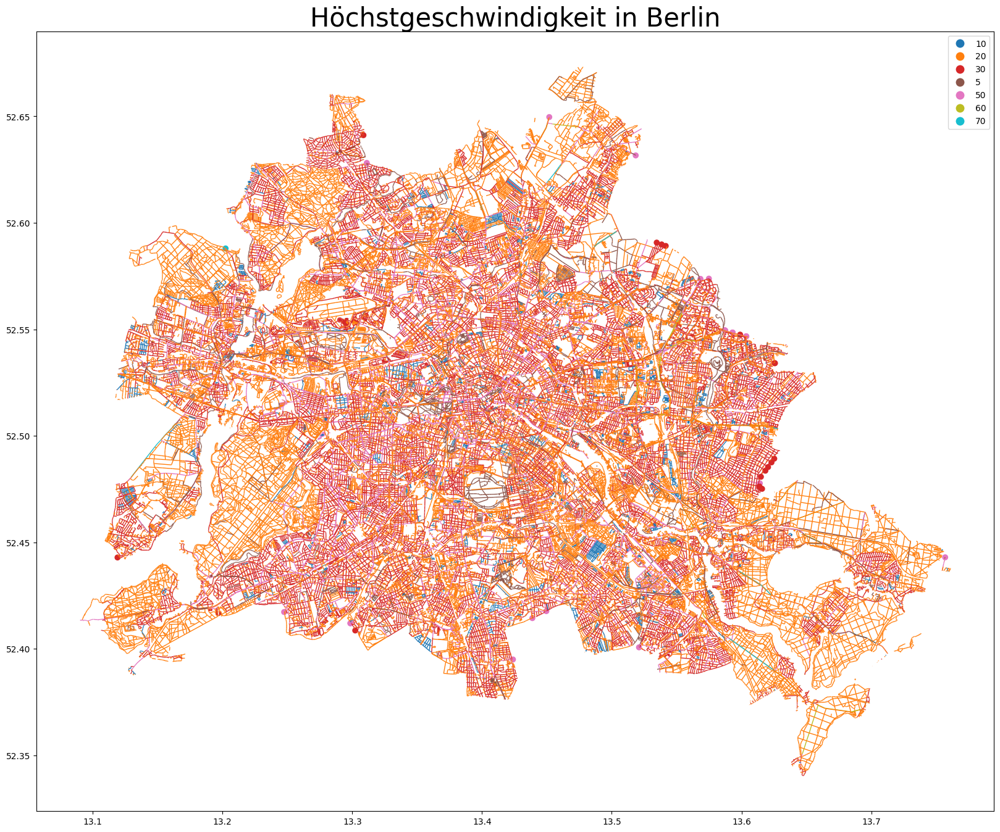

In [40]:
import matplotlib.pyplot as plt
#from matplotlib.colors import ListedColormap
import geopandas as gpd
fig, ax = plt.subplots(1, 1, figsize=(20, 20))
# Verwenden des 'tab20' Farbkarte, um bis zu 20 verschiedene Farben zu unterscheiden
base = osm_maxspeed.plot(column='maxspeed_category', ax=ax, legend=True,
                             cmap='tab10', linewidth=1, legend_kwds={'bbox_to_anchor': (1, 1)})

plt.title("Höchstgeschwindigkeit in Berlin", fontsize=30)
plt.show()